In [1683]:
#import thinkplot
#import thinkstats2
import pandas as pd
import numpy as np
import math
import scipy.stats as ss
import thinkplot
import thinkstats2
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

##Seaborn for fancy plots. 
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams["figure.figsize"] = (15,5)

# Assignment 3 - Basic Predictions and Regression

## Questions

### Part 1 - Election Prediction

Suppose you are looking at an election in a fictional province. There are 7 total elctoral districts, and the winner in each district is determined by a first-past-the-post system (what we have in Canada - the most votes wins, regardless of share). There are two parties - the Purples and the Yellows. Whoever controls the most seats will be the ruling party - so in our 2 party scenario, the party who wins 4 or more of the districts will govern. There is an election every year, they love voting. 

Recent polling indicating the expected vote share in each district is shown in the "dist_polls" table below. These values are a composite of several polls that the experts have combined and weighted. The "Purple" values show the expected vote share of the Purple party, along with the variance of that expectation and the number of polls that were combined to get that result.  

As well, research has shown that the vote distribution is impacted by voter turnout. In general, the more people vote, the more the vote split shifts towards the Yellow party. We have data on past elections and the results, we expect that the turnout will be in line with the past elections - or more specifically, we have no reason to expect it to differ. This impact is measured in the table in code below - that table shows the voter turnout, in a percentage, as well as the change in the Yellow party's vote share (also in percentage) as compared to the polling averages. For example, if one row showed "52" and ".8", that would mean that voter turnout was 52%, and the Yellow party got .8% higher of a vote share than the polling showed. 

<b>What is the probability that the Purple Party controls the government after the election?</b>

<b>Note:</b> the errors and confidence intervals are not totally trivial. As part of the written answer, offer an evaluation of your confidence in the prediction, and why you think that. This is not a question with one specific error, your estimation will have some expected errors, somewhere. You may not have the tools to calculate it all the way through, that's fine. 

### Question 1 - Your Answer in English

Please fill in (and extend if required) the list here to explain what you did. There are multiple reasonable things you could do to approach this, so please note what you did here. For most people I assume this will be about 3-5 statements - you don't need to explain the internals of things we covered (e.g. if there's a hypothesis test, you don't need to explain how that works), just how you structured your approach to the problem. 

<li> Built a Linear regression to predict on average how much improvement Yellows polls would do if they had a 60% voter turnout
<li> Calculated the mean poll turnout for each district to give our simulations something to work with
<li> Built my functions that calculated each simulation ****Note that I adjusted amount to win by 0.377, this is how much purple party needs to win more by because of how much more votes yellow party is going to get based on a 60% voter turnout****
<li> Calculated simulations for each district with a 95% confidence, also showed the worst and best case scenarios for the simulation 
<li> Put each simulation result and error into a list, then built a simple for loop to count how many times purple party gets more than 50% of the votes for each district, thus giving an estimate on the probability Purple was going to win
<li> <b> What do you think about the error/accuracy:</b>
</ul> Errors are mostly the same, averaging around 0.018 for most simulations. I think that this difference could make a reasonable impact impacting the result of the election. Having a 4% increase in yellows votes really did make them much more likely to win the election. So that small of an error could matter, but all in all probably wont impact the result as yellow wins most districts

##### Setup Poll Data

The dataframe "dist_polls" contains all of the polls for each seat. Each value is expressed as expected vote share (as a ratio) for the <b>Purple</b> party. The Yellow party can be safely assumed to get the rest of the votes. 

In [1684]:
# Please don't edit this part. 
# Setup polling data. 
districts = [1,2,3,4,5,6,7]
dist_polls = pd.DataFrame(districts, columns={"district"})

dist_polls["Poll_1"] = [.55, .49, .51, .6, .41, .46, .54]
dist_polls["Poll_2"] = [.53, .51, .51, .62, .44, .48, .53]
dist_polls["Poll_3"] = [.51, .49, .53, .61, .42, .46, .52]
dist_polls["Poll_4"] = [.47, .48, .51, .54, .45, .45, .51]
dist_polls["Poll_5"] = [.61, .52, .49, .73, .44, .51, .53]
dist_polls["Poll_6"] = [.54, .45, .51, .61, .47, .52, .52]
dist_polls["Poll_7"] = [.55, .47, .5, .56, .47, .46, .56]
dist_polls["Poll_8"] = [.53, .49, .51, .55, .43, .49, .55]
dist_polls["Poll_9"] = [.57, .39, .52, .57, .53, .43, .53]


dist_polls.head(10)

,district,Poll_1,Poll_2,Poll_3,Poll_4,Poll_5,Poll_6,Poll_7,Poll_8,Poll_9
0,1,0.55,0.53,0.51,0.47,0.61,0.54,0.55,0.53,0.57
1,2,0.49,0.51,0.49,0.48,0.52,0.45,0.47,0.49,0.39
2,3,0.51,0.51,0.53,0.51,0.49,0.51,0.50,0.51,0.52
3,4,0.60,0.62,0.61,0.54,0.73,0.61,0.56,0.55,0.57
4,5,0.41,0.44,0.42,0.45,0.44,0.47,0.47,0.43,0.53
5,6,0.46,0.48,0.46,0.45,0.51,0.52,0.46,0.49,0.43
6,7,0.54,0.53,0.52,0.51,0.53,0.52,0.56,0.55,0.53


##### Setup Turnout Data

The dataframe "past_vte_table" shows the voter turnout, along with the impact on the votes counted for the <b>Yellow party</b>, all expressed as percentages. For example, if in one row the turnout is .45 and the Yellow_improvement is -.04, that means that 45% of the populace turned out to vote, and the Yellow party got 4% fewer votes than polling indicated. 

In [1685]:
# Please don't edit this part. 
# Setup vote data. 
voter_turnout_history = [.53, .51, .48, .55, .54, .59, .49, .57, .56]
past_vote_table = pd.DataFrame(voter_turnout_history, columns={"voter_turn_percentage"})
past_vote_table["Yellow_improvement"] = [.012, .023, -.017, .031, .030, -.004, -.03, .042, .029]
past_vote_table["year"] = [2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021]
past_vote_table.head(10)

,voter_turn_percentage,Yellow_improvement,year
0,0.53,0.012,2013
1,0.51,0.023,2014
2,0.48,-0.017,2015
3,0.55,0.031,2016
4,0.54,0.030,2017
5,0.59,-0.004,2018
6,0.49,-0.030,2019
7,0.57,0.042,2020
8,0.56,0.029,2021


In [1686]:
yy = np.array(past_vote_table['Yellow_improvement']).reshape(-1,1) 
xx = np.array(past_vote_table["voter_turn_percentage"]).reshape(-1,1) 

voterModel = LinearRegression().fit(xx,yy)
yellowEffect = voterModel.predict(np.array(0.60).reshape(-1,1)) 
yellowEffect


array([[0.03775359]])

## Start Your Work

### Part 1 - Election

In [1687]:
dist_polls['mean'] = dist_polls.iloc[:, 1:9].mean(axis=1)
dist_polls.T
piv = dist_polls.T
piv = piv.drop(axis=0, index={"district"}) 
piv

,0,1,2,3,4,5,6
Poll_1,0.55000,0.4900,0.51000,0.6000,0.41000,0.46000,0.5400
Poll_2,0.53000,0.5100,0.51000,0.6200,0.44000,0.48000,0.5300
Poll_3,0.51000,0.4900,0.53000,0.6100,0.42000,0.46000,0.5200
Poll_4,0.47000,0.4800,0.51000,0.5400,0.45000,0.45000,0.5100
Poll_5,0.61000,0.5200,0.49000,0.7300,0.44000,0.51000,0.5300
Poll_6,0.54000,0.4500,0.51000,0.6100,0.47000,0.52000,0.5200
Poll_7,0.55000,0.4700,0.50000,0.5600,0.47000,0.46000,0.5600
Poll_8,0.53000,0.4900,0.51000,0.5500,0.43000,0.49000,0.5500
Poll_9,0.57000,0.3900,0.52000,0.5700,0.53000,0.43000,0.5300
mean,0.53625,0.4875,0.50875,0.6025,0.44125,0.47875,0.5325


In [1688]:
# Do some stuff

dist1 = 0.53625
dist2 = 0.48750 
dist3 = 0.50875 
dist4 = 0.60250 
dist5 = 0.44125 
dist6 = 0.47875 
dist7 = 0.53250 

In [1689]:
def oneVote(probCalc):
    vote = np.random.binomial(n=1, p=probCalc)
    return vote

In [1690]:
def getSample(voteProb, n=1000):
    vote_list = []
    for i in range(n):
        vote_list.append(oneVote(voteProb))
    return vote_list

In [1691]:
def getSamples(voteProb, n=1000, samples=100, ciLow=2.5, ciHi=97.5):
    meanList = []
    for i in range(samples):
        meanList.append(np.mean(getSample(voteProb, n)))
    muList = [voteProb] * samples
    cdf = thinkstats2.Cdf(meanList) #Make a CDF of the means of the analytical dist's
    ci = cdf.Percentile(ciLow), cdf.Percentile(ciHi) #5th, 95th percentiles. 
    stderr = mean_squared_error(meanList, muList, squared=False)
    return meanList, stderr, cdf, ci

In [1692]:
def simulate(voteProb):
    trials = 1000
    means, err, cdfFin, ciFin= getSamples(voteProb, n=700, samples=trials)
    lowest = means - err
    highest = means + err
    PWins = 0 
    for i in range(len(means)):
        if means[i] > .53775359:
            PWins = PWins + 1
    
    plt.figure()
    sns.kdeplot(means)
    sns.kdeplot(lowest)
    sns.kdeplot(highest)
    thinkplot.axvline(.53775359, color="red")
    
    print("Fraction of Scenarios where Purple wins is %.1f%% " % ((1-cdfFin.Prob(.53775359))*100))
    print("We are 95 percent confident that Purple will get between %.1f%% and %.1f%% percent of the vote in this district" % (ciFin[0]*100, ciFin[1]*100))
    
    plt.figure()
    thinkplot.Cdf(cdfFin)
    thinkplot.axvline(ciFin[0], color="red")
    thinkplot.axvline(ciFin[1], color="red")
    
    return (PWins/trials), err
    

#### District 1

Fraction of Scenarios where Purple wins is 48.2% 
We are 95 percent confident that Purple will get between 50.0% and 57.1% percent of the vote in this district


(0.482, 0.01864332922226596)

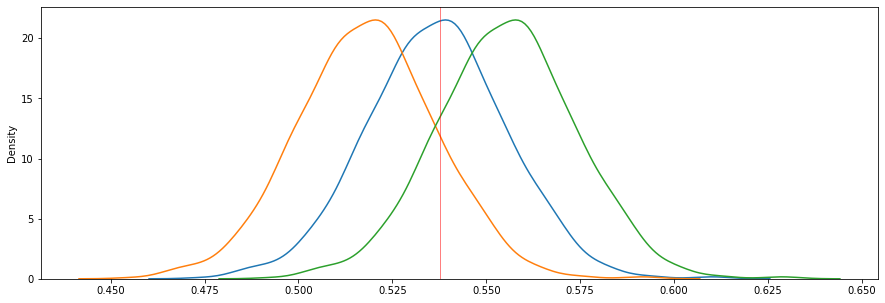

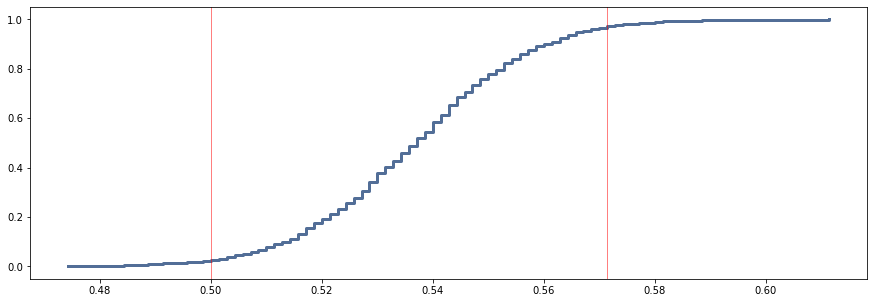

In [1693]:
sim1 = simulate(dist1) 
sim1

In [1694]:
getSamples(dist1, 1000, 5)

([0.538, 0.542, 0.558, 0.526, 0.552],
 0.0131324978583665,
 Cdf([0.526 0.538 0.542 0.552 0.558], [0.2 0.4 0.6 0.8 1. ]),
 (0.526, 0.558))

##### District 2

Fraction of Scenarios where Purple wins is 0.8% 
We are 95 percent confident that Purple will get between 45.0% and 52.6% percent of the vote in this district


(0.008, 0.019255240474070578)

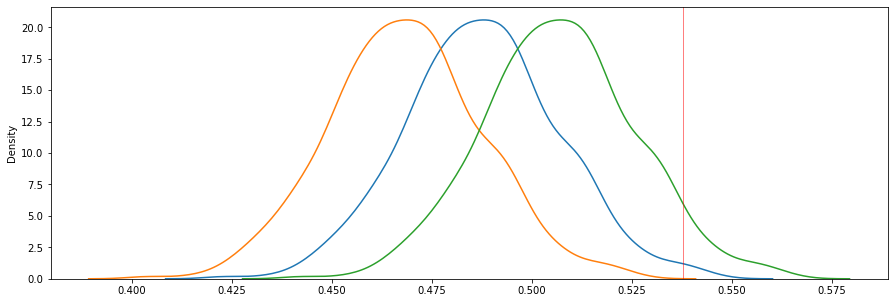

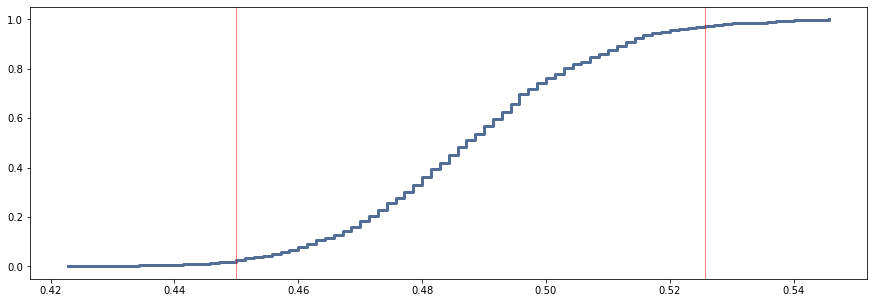

In [1695]:
sim2 = simulate(dist2) 
sim2 

In [1696]:
getSamples(dist2, 1000, 5)

([0.491, 0.459, 0.481, 0.492, 0.511],
 0.016966142755499847,
 Cdf([0.459 0.481 0.491 0.492 0.511], [0.2 0.4 0.6 0.8 1. ]),
 (0.459, 0.511))

#### District 3

Fraction of Scenarios where Purple wins is 6.4% 
We are 95 percent confident that Purple will get between 47.1% and 54.6% percent of the vote in this district


(0.064, 0.018777761760515918)

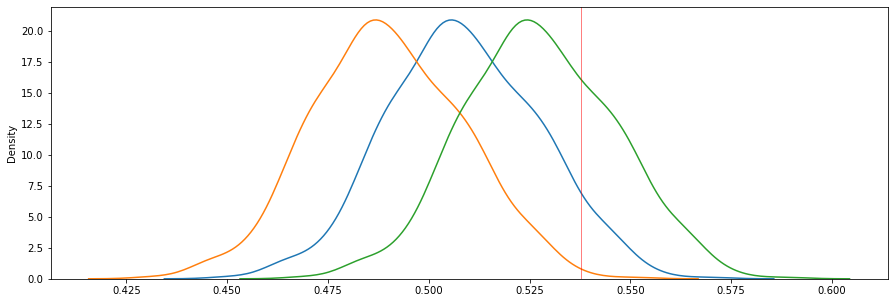

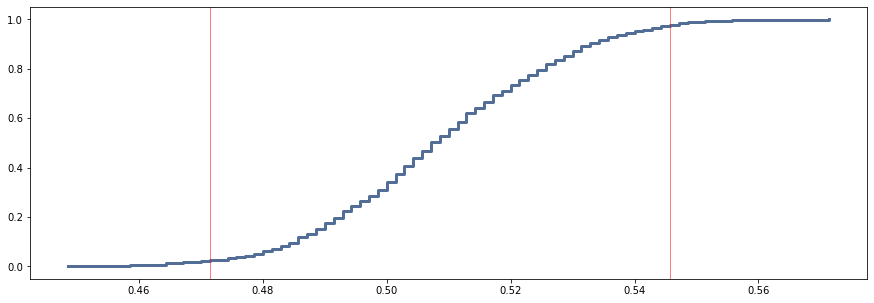

In [1697]:
sim3 = simulate(dist3) 
sim3

In [1698]:
getSamples(dist3, 1000, 5)

([0.53, 0.503, 0.499, 0.508, 0.505],
 0.010902407990898165,
 Cdf([0.499 0.503 0.505 0.508 0.53 ], [0.2 0.4 0.6 0.8 1. ]),
 (0.499, 0.53))

#### District 4

Fraction of Scenarios where Purple wins is 100.0% 
We are 95 percent confident that Purple will get between 56.6% and 64.0% percent of the vote in this district


(1.0, 0.018673292070084852)

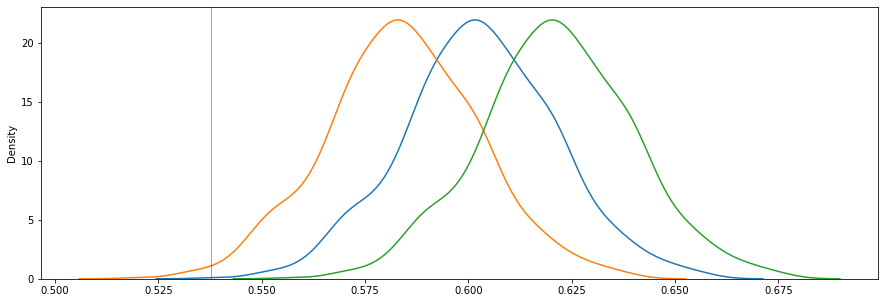

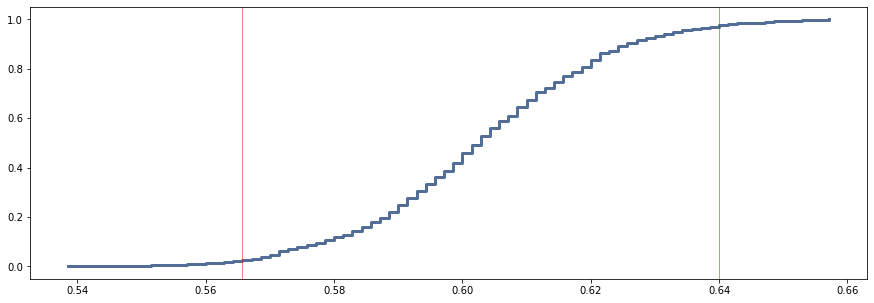

In [1699]:
sim4 = simulate(dist4) 
sim4 

In [1700]:
getSamples(dist4, 1000, 5)

([0.568, 0.602, 0.599, 0.593, 0.623],
 0.018510807653908598,
 Cdf([0.568 0.593 0.599 0.602 0.623], [0.2 0.4 0.6 0.8 1. ]),
 (0.568, 0.623))

#### District 5

Fraction of Scenarios where Purple wins is 0.0% 
We are 95 percent confident that Purple will get between 40.6% and 47.9% percent of the vote in this district


(0.0, 0.018963599664749777)

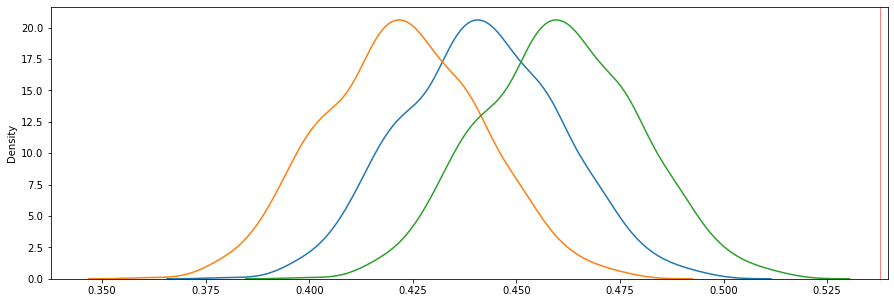

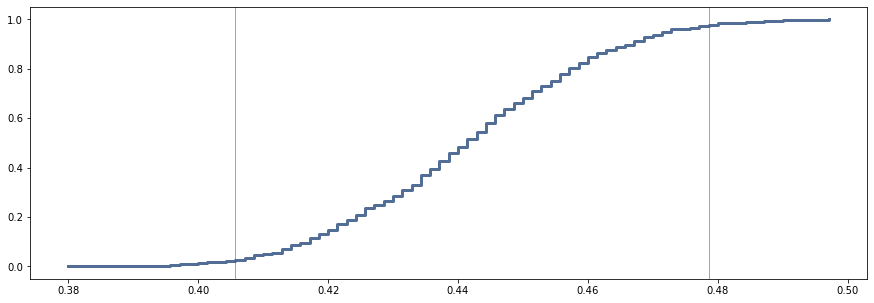

In [1701]:
sim5 = simulate(dist5) 
sim5

In [1702]:
getSamples(dist5, 1000, 5)

([0.44, 0.418, 0.434, 0.419, 0.434],
 0.01511497601718242,
 Cdf([0.418 0.419 0.434 0.44 ], [0.2 0.4 0.8 1. ]),
 (0.418, 0.44))

#### District 6

Fraction of Scenarios where Purple wins is 0.1% 
We are 95 percent confident that Purple will get between 44.3% and 51.7% percent of the vote in this district


(0.001, 0.01885345607899117)

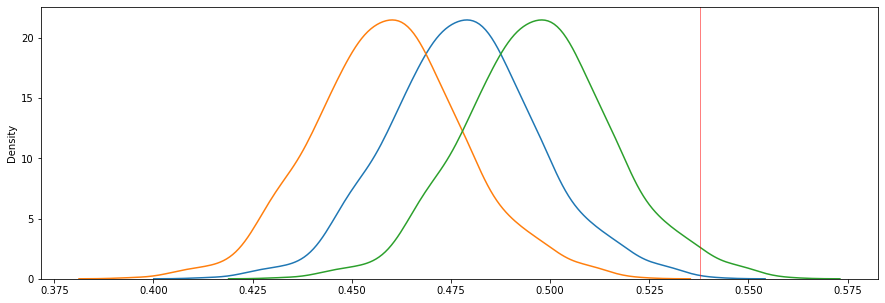

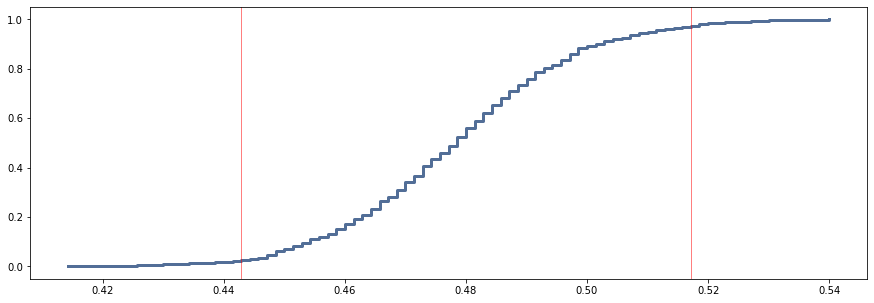

In [1703]:
sim6 = simulate(dist6) 
sim6

In [1704]:
getSamples(dist6, 1000, 5)

([0.461, 0.445, 0.492, 0.479, 0.474],
 0.018178627560957398,
 Cdf([0.445 0.461 0.474 0.479 0.492], [0.2 0.4 0.6 0.8 1. ]),
 (0.445, 0.492))

#### District 7

Fraction of Scenarios where Purple wins is 38.4% 
We are 95 percent confident that Purple will get between 49.6% and 56.9% percent of the vote in this district


(0.384, 0.018680148799826875)

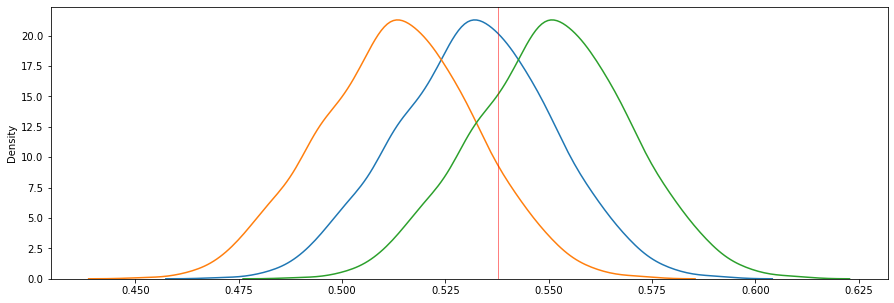

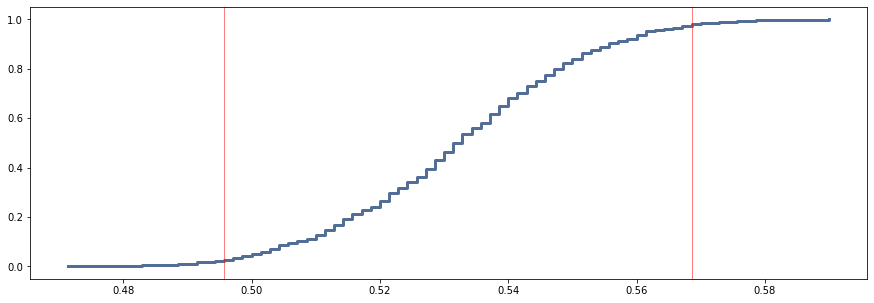

In [1705]:
sim7 = simulate(dist7) 
sim7

In [1706]:
getSamples(dist7, 1000, 5)

([0.541, 0.517, 0.523, 0.52, 0.53],
 0.01063249735480802,
 Cdf([0.517 0.52  0.523 0.53  0.541], [0.2 0.4 0.6 0.8 1. ]),
 (0.517, 0.541))

#### What is the probability that the Purple party is going to win?

In [1707]:
chancesperDistrict = [] 
errors = [] 

chancesperDistrict.append(sim1[0]) 
errors.append(sim1[1]) 
chancesperDistrict.append(sim2[0]) 
errors.append(sim2[1])
chancesperDistrict.append(sim3[0]) 
errors.append(sim3[1])
chancesperDistrict.append(sim4[0]) 
errors.append(sim4[1])
chancesperDistrict.append(sim5[0]) 
errors.append(sim5[1])
chancesperDistrict.append(sim6[0]) 
errors.append(sim6[1])
chancesperDistrict.append(sim7[0]) 
errors.append(sim7[1])

In [1708]:
print('The Purple party has a '+str(chancesperDistrict[0]*100)+'% chance to win district 1, a '+str(chancesperDistrict[1]*100)+'% chance to win district 2, a '+str(chancesperDistrict[2]*100)+'% chance to win district 3, a '+str(chancesperDistrict[3]*100)+'% chance to win district 4, a '+str(chancesperDistrict[4]*100)+'% chance to win district 5, a '+str(chancesperDistrict[5]*100)+'% chance to win district 6, a '+str(chancesperDistrict[6]*100)+'% chance to win district 7')

print(errors)

The Purple party has a 48.199999999999996% chance to win district 1, a 0.8% chance to win district 2, a 6.4% chance to win district 3, a 100.0% chance to win district 4, a 0.0% chance to win district 5, a 0.1% chance to win district 6, a 38.4% chance to win district 7
[0.01864332922226596, 0.019255240474070578, 0.018777761760515918, 0.018673292070084852, 0.018963599664749777, 0.01885345607899117, 0.018680148799826875]


In [1709]:
PWins = 0
for i in range(len(chancesperDistrict)):
        if chancesperDistrict[i] > 0.5:
            PWins += 1 
            print(PWins)

1


#### After running all of the simulations we can see that the Purple party only wins 1 out of the 7! We could make an argument for maybe 2 of the 7 as purple party has a pretty even chance to win in district 1 but ultimately is still slightly in favor of yellow. Also note that this is already based on an average so this is still just an estimate but all in all a fairly reasonable estimate to say the least. We can see that having a voter turnout of 60% really does impact whether yellow party is going to win, even if it is only a measley 4% difference!

### Part 2 - Regression

<b>Use the data provided to try to predict the wage. </b>

The data is from FIFA rankings for players. You don't need to know anything about soccer or video games for this, so if these values are meaningless to you, just treat them as numbers and you'll be fine. All of the features are rankings are evaluations of how good different soccar players are at different skills.

#### Answer in English

Please fill in (and extend if required) the list here to explain what you did. There are multiple reasonable things you could do to approach this, so please note what you did here. For most people I assume this will be about 3-5 statements - you don't need to explain the internals of things we covered (e.g. if there's a hypothesis test, you don't need to explain how that works), just how you structured your approach to the problem. 

<li> Described the data to get a good look at the columns
<li>Filtered out some outliers and ultimately decided to filter out people who dont make any wage cuase it doesnt really make sense to be in apart of FIFA and make no money what so ever. Also decided to filter out people who made over 100,000 just to make our model a bit more accurate. Sorry Ronaldo but you just make too much money compared to all the other fifa chums. 
<li> Made a pairplot to just get a look at the data, decided not to filter out any columns as they are all fairly relevant. Im sure there is also some Colinearity but it would not make much difference to filter out in regards to our accuracy
<li> I shaped the data and found that i was getting the correct columns
<li> I Trained and split the data so it could be usable for a multi regression and ran it. I found that the predictions i was making were too low for my liking so I started playing around with the data and tried to make it higher. 
<li> I found that the best way was to use a polynomial regression to the 3rd degree. Which i guess it makes sense cause if we look at the wage scatter plots, we see that the relationships are not as normal. So I believe a polynomial regression fits better. 
<li> Then found I had an RMSE of 6260 and an R2 of about 0.76. So with this model we can say that we are making reasonably good predictions given the other data in relation to wage!
</ul>

In [1710]:
df = pd.read_csv("players_20_2.csv")
df.head()

,wage_eur,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,...,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle
0,565000,88,95,70,92,88,97,93,94,92,...,94,48,40,94,94,75,96,33,37,26
1,405000,84,94,89,83,87,89,81,76,77,...,93,63,29,95,82,85,95,28,32,24
2,290000,87,87,62,87,87,96,88,87,81,...,84,51,36,87,90,90,94,27,26,29
3,125000,13,11,15,43,13,12,13,14,40,...,12,34,19,11,65,11,68,27,12,18
4,470000,81,84,61,89,83,95,83,79,83,...,80,54,41,87,89,88,91,34,27,22


In [1711]:
df.describe()

,wage_eur,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,...,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle
count,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,...,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000
mean,9456.942773,49.718405,45.590218,52.221468,58.748003,42.809388,55.596509,47.325692,42.708885,52.768848,...,46.812945,55.742149,46.380239,50.072163,53.609749,48.383357,58.528778,46.848889,47.640333,45.606631
std,21351.714095,18.325403,19.594609,17.428429,14.679653,17.701815,18.929118,18.422991,17.433612,15.246454,...,19.322343,17.318157,20.775812,19.594022,13.955626,15.708099,11.880840,20.091287,21.585641,21.217734
min,0.000000,5.000000,2.000000,5.000000,7.000000,3.000000,4.000000,6.000000,4.000000,8.000000,...,4.000000,9.000000,3.000000,2.000000,9.000000,7.000000,12.000000,1.000000,5.000000,3.000000
25%,1000.000000,38.000000,30.000000,44.000000,54.000000,30.000000,50.000000,34.000000,31.000000,43.000000,...,32.000000,44.000000,25.000000,39.000000,44.000000,39.000000,51.000000,29.000000,27.000000,24.000000
50%,3000.000000,54.000000,49.000000,56.000000,62.000000,44.000000,61.000000,49.000000,41.000000,56.000000,...,51.000000,58.000000,52.000000,55.000000,55.000000,49.000000,60.000000,52.000000,55.000000,52.000000
75%,8000.000000,64.000000,62.000000,64.000000,68.000000,56.000000,68.000000,62.000000,56.000000,64.000000,...,62.000000,69.000000,64.000000,64.000000,64.000000,60.000000,67.000000,64.000000,66.000000,64.000000
max,565000.000000,93.000000,95.000000,93.000000,92.000000,90.000000,97.000000,94.000000,94.000000,92.000000,...,94.000000,95.000000,92.000000,95.000000,94.000000,92.000000,96.000000,94.000000,92.000000,90.000000


In [1806]:
dfLE = df[df["wage_eur"] > 100] 
dfLE = dfLE[df["wage_eur"] < 100000]
dfLE.describe()

C:\Users\Luke\AppData\Local\Temp\ipykernel_27676\1812059580.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  dfLE = dfLE[df["wage_eur"] < 100000]


,wage_eur,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,...,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle
count,17865.000000,17865.000000,17865.000000,17865.000000,17865.000000,17865.000000,17865.000000,17865.000000,17865.000000,17865.000000,...,17865.000000,17865.000000,17865.000000,17865.000000,17865.000000,17865.000000,17865.000000,17865.000000,17865.000000,17865.000000
mean,8029.051217,49.539323,45.419144,52.075623,58.565631,42.606269,55.443773,47.139099,42.519787,52.554212,...,46.616065,55.585838,46.206829,49.905122,53.405989,48.225805,58.279373,46.695886,47.504730,45.484859
std,12800.074701,18.198439,19.455806,17.313097,14.537818,17.505243,18.807379,18.260924,17.279060,15.122551,...,19.175165,17.246385,20.680514,19.448118,13.783688,15.592434,11.678454,19.980405,21.483111,21.106680
min,1000.000000,5.000000,2.000000,5.000000,7.000000,3.000000,4.000000,6.000000,4.000000,8.000000,...,4.000000,9.000000,3.000000,2.000000,9.000000,7.000000,12.000000,1.000000,5.000000,3.000000
25%,1000.000000,38.000000,30.000000,44.000000,54.000000,30.000000,49.000000,34.000000,30.000000,43.000000,...,32.000000,44.000000,25.000000,39.000000,44.000000,39.000000,51.000000,29.000000,27.000000,24.000000
50%,3000.000000,54.000000,49.000000,55.000000,62.000000,43.000000,61.000000,49.000000,41.000000,56.000000,...,51.000000,58.000000,52.000000,55.000000,55.000000,49.000000,59.000000,52.000000,55.000000,52.000000
75%,8000.000000,63.000000,61.000000,64.000000,68.000000,56.000000,68.000000,62.000000,56.000000,64.000000,...,62.000000,69.000000,64.000000,64.000000,64.000000,60.000000,66.000000,63.000000,66.000000,64.000000
max,99000.000000,91.000000,89.000000,93.000000,91.000000,88.000000,92.000000,94.000000,92.000000,89.000000,...,90.000000,95.000000,87.000000,91.000000,89.000000,91.000000,92.000000,92.000000,87.000000,90.000000


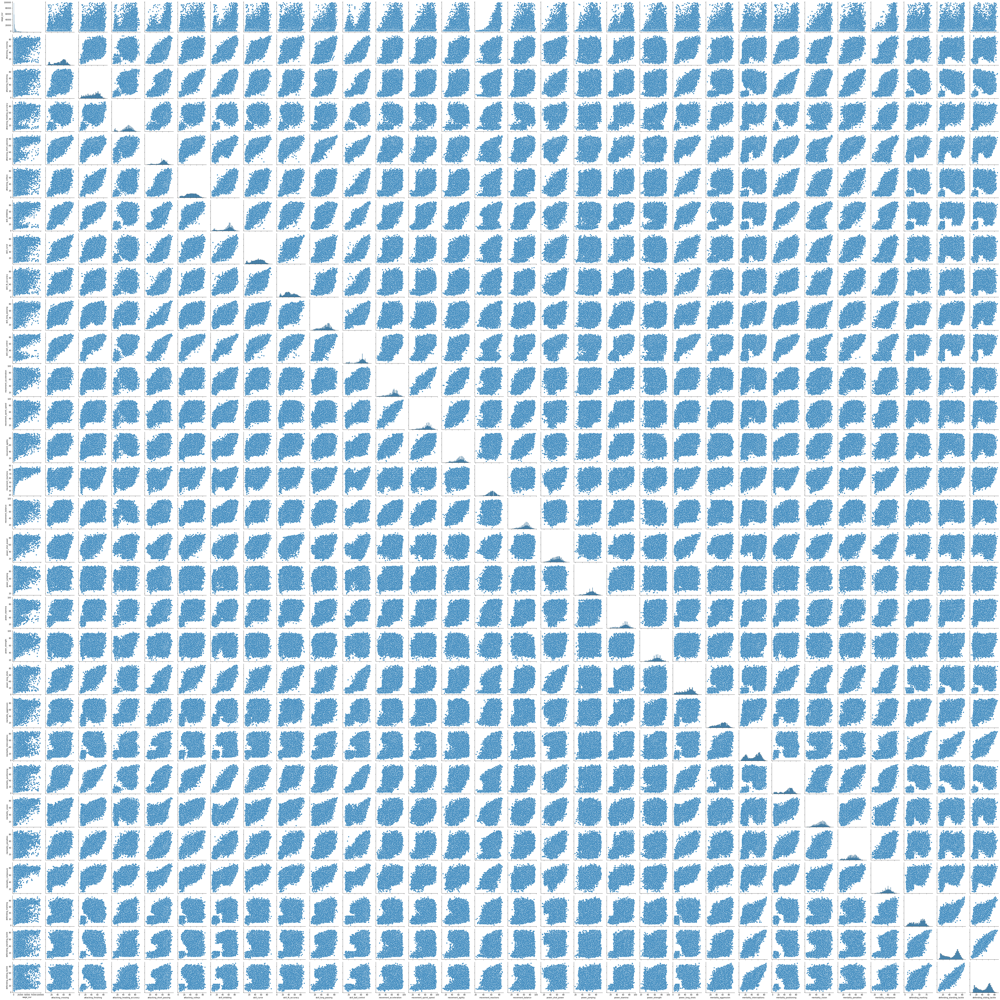

In [1807]:
sns.pairplot(dfLE)

In [1808]:
y = np.array(dfLE["wage_eur"]).reshape(-1,1)
x = np.array(dfLE.drop(columns={"wage_eur"}))
x.shape, y.shape

((17865, 29), (17865, 1))

In [1809]:
#Split and Train
xTrainE, xTestE, yTrainE, yTestE = train_test_split(x,y,test_size=.3, random_state =0)
#Generate model 
modelE = LinearRegression().fit(xTrainE,yTrainE)

In [1810]:
tmpE = modelE.predict(xTestE)
rmseE = mean_squared_error(tmpE, yTestE, squared=False)
r_sqE = modelE.score(xTestE, yTestE)

print("RMSE:", rmseE)
print('R-squared:', r_sqE)

RMSE: 10226.1837408581
R-squared: 0.36803664492656885


In [1811]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

poly = PolynomialFeatures(degree=3)
m2 = make_pipeline(poly, LinearRegression())
m2.fit(x,y)
ypred = m2.predict(x)

In [1812]:
rmse = np.sqrt(mean_squared_error(y,ypred))
r2 = m2.score(x,y)
print("RMSE:", rmse)
print("R2:", r2) 

RMSE: 6260.073135977387
R2: 0.7608016848832325
